In [1]:
#https://huggingface.co/blog/controlnet
#https://blog.shikoan.com/controlnet_lora/
!pip install --upgrade pip --quiet
!pip install --upgrade torchvision --quiet
!pip install --upgrade torch --quiet
!pip install diffusers transformers xformers git+https://github.com/huggingface/accelerate.git --quiet
!pip install opencv-contrib-python --quiet
!pip install controlnet_aux --quiet
!pip install mediapipe --quiet

In [2]:
!pip list |grep torch

open-clip-torch                     2.19.0
pytorch-lightning                   2.0.2
torch                               2.0.1
torchmetrics                        0.11.4
torchvision                         0.15.2
torchviz                            0.0.2


In [4]:
import torch
from diffusers import StableDiffusionPipeline

# パイプラインの準備
pipe = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", 
    revision="fp16", 
    torch_dtype=torch.float16,
)
pipe = pipe.to("cuda")
pipe.enable_xformers_memory_efficient_attention()
pipe.vae.enable_tiling()

# 推論の実行
prompt = "a beautiful landscape photo"
image = pipe(
    prompt, 
    width=4096, 
    height=2048, 
    num_inference_steps=10
).images[0]
image.save("4k_landscape.jpg")

vae/diffusion_pytorch_model.safetensors not found


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


  0%|          | 0/10 [00:00<?, ?it/s]

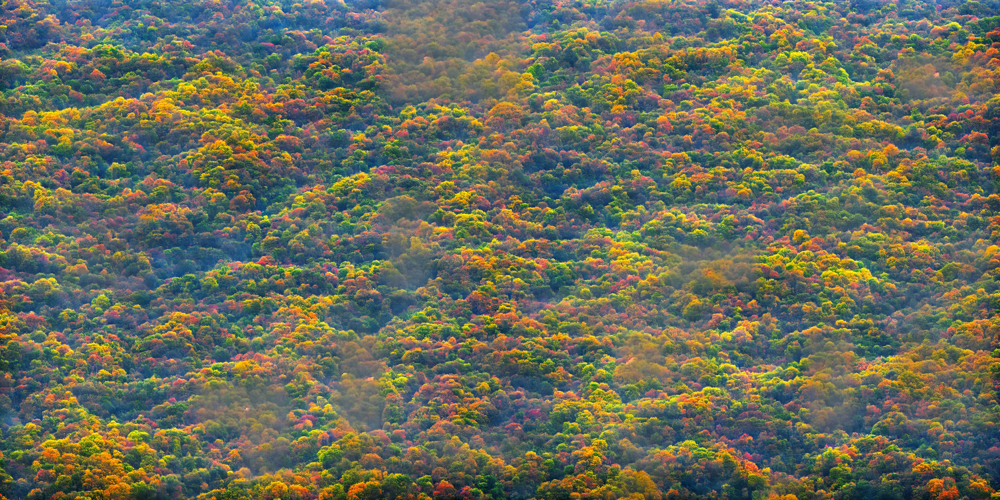

In [5]:
from PIL import Image

image = Image.open("4k_landscape.jpg")
image.show()